# Рынок заведений общественного питания Москвы #

<br>Задача:

Инвесторы из фонда «Shut Up and Take My Money» решили попробовать себя в новой области и открыть заведение общественного питания в Москве. Заказчики ещё не знают, что это будет за место: кафе, ресторан, пиццерия, паб или бар, — и какими будут расположение, меню и цены.

Необходимо подготовить исследование рынка Москвы, найти интересные особенности и презентовать полученные результаты, которые в будущем помогут в выборе подходящего инвесторам места.

<br>План:
1. Открыть фаил с данными и изучить общую информацию.
2. Провести предобработку данных:
    - Проверить данные на наличие пропусков
    - Изучить дубликаты в датафрейме
    - Проверить количественные значения
    
3. Провести исследовательский анализ данных:
    - Выяснить какие категории заведений представлены в данных
    - Исследовать количество посадочных мест в местах по категориям
    - Исследовать соотношение сетевых и несетевых заведений
    - Исследовать какие категории заведений чаще являются сетевыми
    - Выявить топ-15 сетей Москвы
    - Исследовать как распределяются заведения по районам Москвы
    - Проанализировать распределение средних рейтингов по категориям заведений
    - Построить фоновую картограмму (хороплет) со средним рейтингом заведений каждого района
    - Отобразить все заведения датасета на карте с помощью кластеров средствами библиотеки
    - Выявить топ-15 улиц по количеству заведений
    - Отобразить улицы, где находится только один объект общепита
    - Посчитать средний чек для каждого района

    - Исследовать фильмы, которые получили государственную поддержку
4. Детализировать исследование открытия кофейни:
    - Определить сколько кофеин в датасете и как они распределяются по районам
    - Определить как распределяются рейтинги кофеен по районам
    - Проанализировать наличие круглосуточных кофеен
    - Определить стоимость чашки кофе при открытии кофейни
    
5. Подготовить презентацию
    
</div>

### Шаг 1. Загрузим данные и изучим общую информацию

In [4]:
# Испортируем необходимые для работы библиотеки
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import plotly.express as px

In [5]:
# Откроем датасет и сохраним его в переменную data
places = pd.read_csv('/music/Practicum_projects/moscow_catering/moscow_places.csv')

In [6]:
# Выведем первые три строки датасета
places.head(3)

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN
1,Четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0
2,Хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0


In [7]:
# Выведем на экран информацию о датасете
places.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8406 entries, 0 to 8405
Data columns (total 14 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               8406 non-null   object 
 1   category           8406 non-null   object 
 2   address            8406 non-null   object 
 3   district           8406 non-null   object 
 4   hours              7870 non-null   object 
 5   lat                8406 non-null   float64
 6   lng                8406 non-null   float64
 7   rating             8406 non-null   float64
 8   price              3315 non-null   object 
 9   avg_bill           3816 non-null   object 
 10  middle_avg_bill    3149 non-null   float64
 11  middle_coffee_cup  535 non-null    float64
 12  chain              8406 non-null   int64  
 13  seats              4795 non-null   float64
dtypes: float64(6), int64(1), object(7)
memory usage: 919.5+ KB


### Шаг 2. Предобработка данных

#### Шаг 2.1. Проверим данные на наличие пропусков

In [10]:
places.isna().sum().sort_values()

name                    0
category                0
address                 0
district                0
lat                     0
lng                     0
rating                  0
chain                   0
hours                 536
seats                3611
avg_bill             4590
price                5091
middle_avg_bill      5257
middle_coffee_cup    7871
dtype: int64

In [11]:
pd.DataFrame(round(places.isna().mean().sort_values(ascending=False)*100,1)).style.background_gradient('coolwarm')

,0
middle_coffee_cup,93.600000
middle_avg_bill,62.500000
price,60.600000
avg_bill,54.600000
seats,43.000000
hours,6.400000
name,0.000000
category,0.000000
address,0.000000
district,0.000000


Пропуски имеются в часах работы, среднем чеке, количестве посадочных мест. Их много. Не имеет смысла удалять, так как не останется данных для исследования. Но будем это иметь в виду при дальнейшем анализе.

#### Шаг 2.1. Проверим данные на наличие дубликатов

In [14]:
places.duplicated().sum()

0

Явных дубликатов нет.

In [16]:
# Приведем столбец с названием к нижнему регистру
places['name'] = places['name'].str.lower()

# Проверим дубликаты по адресу и названиею заведения
places[places[['name', 'address']].duplicated()]

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
1511,more poke,ресторан,"Москва, Волоколамское шоссе, 11, стр. 2",Северный административный округ,"пн-чт 09:00–18:00; пт,сб 09:00–21:00; вс 09:00...",55.806307,37.497566,4.2,NaN,NaN,NaN,NaN,1,188.0
2420,раковарня клешни и хвосты,"бар,паб","Москва, проспект Мира, 118",Северо-Восточный административный округ,"пн-чт 12:00–00:00; пт,сб 12:00–01:00; вс 12:00...",55.810677,37.638379,4.4,NaN,NaN,NaN,NaN,1,150.0
3109,хлеб да выпечка,кафе,"Москва, Ярцевская улица, 19",Западный административный округ,NaN,55.738449,37.410937,4.1,NaN,NaN,NaN,NaN,0,276.0


Найдено 3 дубликата. Удалим их.

In [18]:
places = places.drop(index=[1511, 2420, 3109])

Проверим на наличие дубликатов среди районов и категорий заведений

In [20]:
display (places['district'].unique())

array(['Северный административный округ',
       'Северо-Восточный административный округ',
       'Северо-Западный административный округ',
       'Западный административный округ',
       'Центральный административный округ',
       'Восточный административный округ',
       'Юго-Восточный административный округ',
       'Южный административный округ',
       'Юго-Западный административный округ'], dtype=object)

In [21]:
display (places['category'].unique())

array(['кафе', 'ресторан', 'кофейня', 'пиццерия', 'бар,паб',
       'быстрое питание', 'булочная', 'столовая'], dtype=object)

Дубликатов нет.

#### Шаг 2.1. Добавим новые столбцы

In [24]:
places['street']=places['address'].str.split(', ',expand=True)[1] 

In [25]:
places['is_24/7'] = places['hours'].str.contains(r'\ежедневно, круглосуточно')

#### Шаг 2.2. Проверка количественных значений

In [27]:
places.describe()

,lat,lng,rating,middle_avg_bill,middle_coffee_cup,chain,seats
count,8403.000000,8403.000000,8403.000000,3149.000000,535.000000,8403.000000,4792.000000
mean,55.750096,37.608604,4.229894,958.053668,174.721495,0.381173,108.361436
std,0.069664,0.098583,0.470426,1009.732845,88.951103,0.485704,122.841130
min,55.573942,37.355651,1.000000,0.000000,60.000000,0.000000,0.000000
25%,55.705018,37.538637,4.100000,375.000000,124.500000,0.000000,40.000000
50%,55.753407,37.605260,4.300000,750.000000,169.000000,0.000000,75.000000
75%,55.795028,37.664810,4.400000,1250.000000,225.000000,1.000000,140.000000
max,55.928943,37.874466,5.000000,35000.000000,1568.000000,1.000000,1288.000000


Есть аномальные значения в столбце middle_avg_bill; middle_coffee_cup и seats.

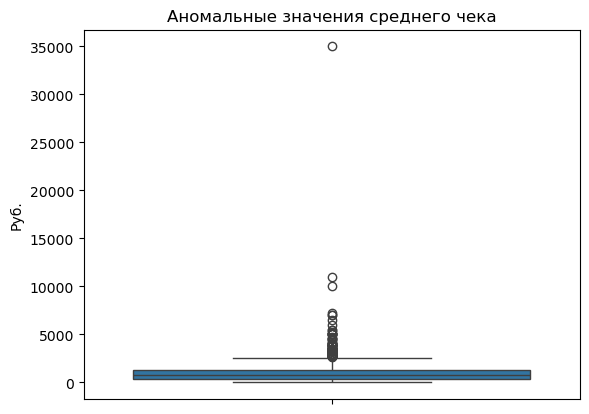

In [29]:
sns.boxplot (y = places['middle_avg_bill']);
plt.title('Аномальные значения среднего чека')
plt.ylabel('Руб.');

In [30]:
places[places['middle_avg_bill']>3000]

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7
317,vоdный,ресторан,"Москва, Ленинградское шоссе, 39, стр. 6",Северный административный округ,"ежедневно, 12:00–00:00",55.834978,37.479791,4.7,высокие,Средний счёт:4500–5500 ₽,5000.0,NaN,0,286.0,Ленинградское шоссе,False
354,стар самарканд,ресторан,"Москва, Ленинградское шоссе, 84, стр. 1",Северный административный округ,"ежедневно, 07:00–02:00",55.848269,37.475768,4.4,высокие,Средний счёт:1500–5000 ₽,3250.0,NaN,0,84.0,Ленинградское шоссе,False
730,чойхона,"бар,паб","Москва, Дмитровское шоссе, 95А",Северный административный округ,"ежедневно, 10:00–23:00",55.871497,37.543555,4.4,высокие,Средний счёт:5000–17000 ₽,11000.0,NaN,0,49.0,Дмитровское шоссе,False
754,золотая роща,ресторан,"Москва, улица Бестужевых, 14, корп. 1",Северо-Восточный административный округ,"пн-чт 12:00–00:00; пт,сб 12:00–01:00; вс 12:00...",55.871153,37.609928,4.3,высокие,Средний счёт:3500–4000 ₽,3750.0,NaN,0,300.0,улица Бестужевых,False
1125,на мангале,кафе,"Москва, проспект Мира, 119, стр. 503",Северо-Восточный административный округ,"ежедневно, 10:00–21:00",55.830405,37.617687,1.0,высокие,Средний счёт:4000–5000 ₽,4500.0,NaN,0,NaN,проспект Мира,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5724,garum,ресторан,"Москва, Мичуринский проспект, 16",Западный административный округ,"пн-пт 15:00–01:00; сб,вс 13:00–23:00",55.702328,37.505930,4.5,высокие,Средний счёт:2000–5000 ₽,3500.0,NaN,0,60.0,Мичуринский проспект,False
5978,буйабес,ресторан,"Москва, Ленинский проспект, 37",Южный административный округ,"ежедневно, 12:00–23:00",55.711015,37.586544,4.2,высокие,Средний счёт:от 3500 ₽,3500.0,NaN,0,96.0,Ленинский проспект,False
6349,дудук,ресторан,"Москва, улица Симоновский Вал, 26, корп. 2",Южный административный округ,"ежедневно, 11:00–23:00",55.718072,37.661702,4.6,высокие,Средний счёт:2500–4500 ₽,3500.0,NaN,0,130.0,улица Симоновский Вал,False
7177,кафе,ресторан,"Москва, Каширское шоссе, 23, стр. 2",Южный административный округ,"ежедневно, круглосуточно",55.657450,37.646665,4.1,высокие,Средний счёт:20000–50000 ₽,35000.0,NaN,0,100.0,Каширское шоссе,True


61 строка, меньше одного процента. Удалим эти строки.

In [32]:
places = places.drop(np.where(places['middle_avg_bill']>3000)[0])

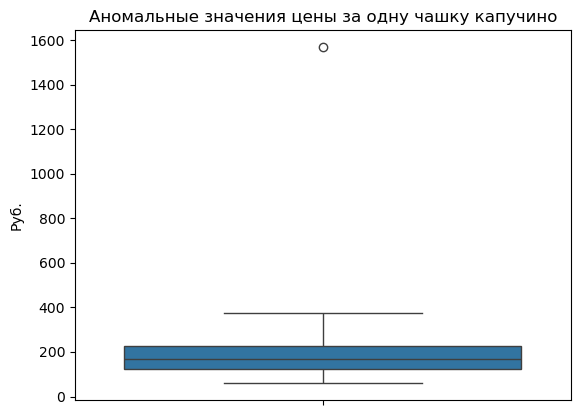

In [33]:
sns.boxplot (y = places['middle_coffee_cup']);
plt.title('Аномальные значения цены за одну чашку капучино')
plt.ylabel('Руб.');

In [34]:
places[places['middle_coffee_cup']>1400]

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7
2859,шоколадница,кофейня,"Москва, Большая Семёновская улица, 27, корп. 1",Восточный административный округ,"ежедневно, 08:00–23:00",55.782268,37.709022,4.2,средние,Цена чашки капучино:230–2907 ₽,NaN,1568.0,1,48.0,Большая Семёновская улица,False


Похоже это опечатка. Удалим эту строку.

In [36]:
places = places.drop(index=[2859])

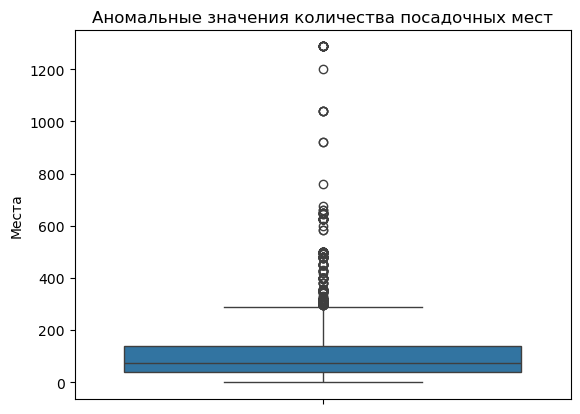

In [37]:
sns.boxplot (y = places['seats']);
plt.title('Аномальные значения количества посадочных мест')
plt.ylabel('Места');

In [38]:
places[places['seats']>300]

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7
127,арарат,кафе,"Москва, Дмитровское шоссе, 165, корп. 1",Северо-Восточный административный округ,"ежедневно, 06:00–20:00",55.914310,37.538953,4.2,NaN,NaN,NaN,NaN,1,350.0,Дмитровское шоссе,False
171,one price coffee,кофейня,"Москва, Дмитровское шоссе, 163А, корп. 1",Северо-Восточный административный округ,"ежедневно, 10:00–22:00",55.909838,37.541526,4.0,NaN,NaN,NaN,NaN,1,350.0,Дмитровское шоссе,False
176,вуди пицца,пиццерия,"Москва, Дмитровское шоссе, 107А, корп. 1",Северный административный округ,"пн-пт 08:00–21:00; сб,вс 09:00–21:00",55.878504,37.540110,4.0,средние,Средний счёт:400–600 ₽,500.0,NaN,0,350.0,Дмитровское шоссе,False
194,ленкорань,кафе,"Москва, Дмитровское шоссе, 165, корп. 1",Северо-Восточный административный округ,"ежедневно, 06:00–20:00",55.914574,37.539103,1.4,NaN,NaN,NaN,NaN,0,350.0,Дмитровское шоссе,False
216,грузинский бульвар,быстрое питание,"Москва, Дмитровское шоссе, 163А, корп. 1",Северо-Восточный административный округ,"ежедневно, 10:00–22:00",55.909115,37.540112,4.0,NaN,NaN,NaN,NaN,0,350.0,Дмитровское шоссе,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8171,монстер хиллс,ресторан,"Москва, Автозаводская улица, 18",Южный административный округ,"ежедневно, 10:00–22:00",55.705457,37.638930,4.0,средние,Средний счёт:600–1200 ₽,900.0,NaN,0,455.0,Автозаводская улица,False
8198,милти,быстрое питание,"Москва, улица Ленинская Слобода, 19",Южный административный округ,пн-пт 09:00–19:00,55.708303,37.652822,3.8,NaN,NaN,NaN,NaN,0,450.0,улица Ленинская Слобода,False
8237,pasta cup & pinsa,пиццерия,"Москва, Автозаводская улица, 18",Южный административный округ,"ежедневно, 10:00–22:00",55.704647,37.639556,3.5,средние,Средний счёт:450–700 ₽,575.0,NaN,0,455.0,Автозаводская улица,False
8315,чайхана бишкек,ресторан,"Москва, Тихорецкий бульвар, 2, корп. 1",Юго-Восточный административный округ,"ежедневно, 09:00–01:30",55.679190,37.776553,4.1,NaN,NaN,NaN,NaN,0,305.0,Тихорецкий бульвар,False


Таких заведений довольно много (3%). Оставим их в датасете.

### Шаг 3. Анализ данных

#### Посмотрим какие категории заведений представлены в данных. Исследуем количество объектов общественного питания по категориям: рестораны, кофейни, пиццерии, бары и так далее

In [42]:
category_count = places.groupby('category')['name'].count().sort_values().reset_index()
category_count.columns = ['category', 'count']
category_count

,category,count
0,булочная,254
1,столовая,314
2,быстрое питание,600
3,пиццерия,626
4,"бар,паб",755
5,кофейня,1410
6,ресторан,2021
7,кафе,2361


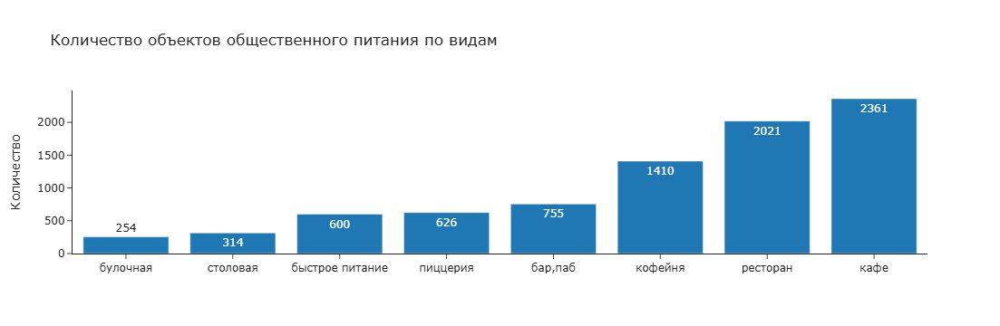

In [43]:
fig = px.bar(category_count, 
             x='category', 
             y='count', 
             text='count',
             title='Количество объектов общественного питания по видам',
             template='simple_white'
            )

fig.update_layout(xaxis_title='',
                  yaxis_title='Количество',
                  xaxis={'categoryorder':'total ascending'})

fig.show()

Первая тройка лидеров: кафе, рестораны и кофейни. В кафе относительно недорого. При этом там можно и поесть, и попить кофе (или чай). То есть, это универсальный вариант. На втором месте рестораны. Это те же кафе, только дороже. В рестораны ходят чаще вечером и на выходных.

#### Исследуем количество посадочных мест в местах по категориям: рестораны, кофейни, пиццерии, бары и так далее

In [46]:
category_seats = places.pivot_table (index = 'category', values = 'seats', aggfunc = 'median').sort_values(by='seats').reset_index()
category_seats

,category,seats
0,булочная,50.0
1,пиццерия,55.0
2,кафе,60.0
3,быстрое питание,65.0
4,столовая,76.0
5,кофейня,80.0
6,"бар,паб",82.0
7,ресторан,86.0


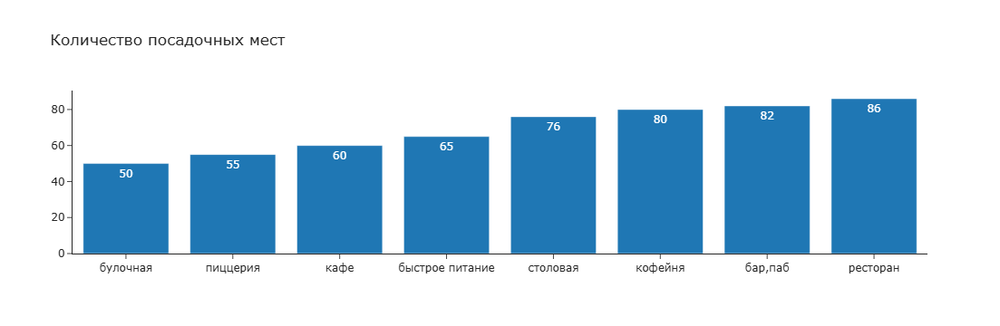

In [47]:
fig = px.bar(category_seats, 
             x='category', 
             y='seats',
             text='seats',
             title='Количество посадочных мест',
             template='simple_white'
            )

fig.update_layout(xaxis_title='',
                  yaxis_title='',
                  )

fig.show()

Количество посадочных мест варьируется от 50 до 85. Больше всего в ресторанах. Меньше всего в булочных.

#### Исследуем соотношение сетевых и несетевых заведений в датасете

In [50]:
chain_count = places.groupby('chain')['name'].count().sort_values().reset_index()
chain_count.columns = ['chain/not_chain', 'count']
chain_count

,chain/not_chain,count
0,1,3181
1,0,5160


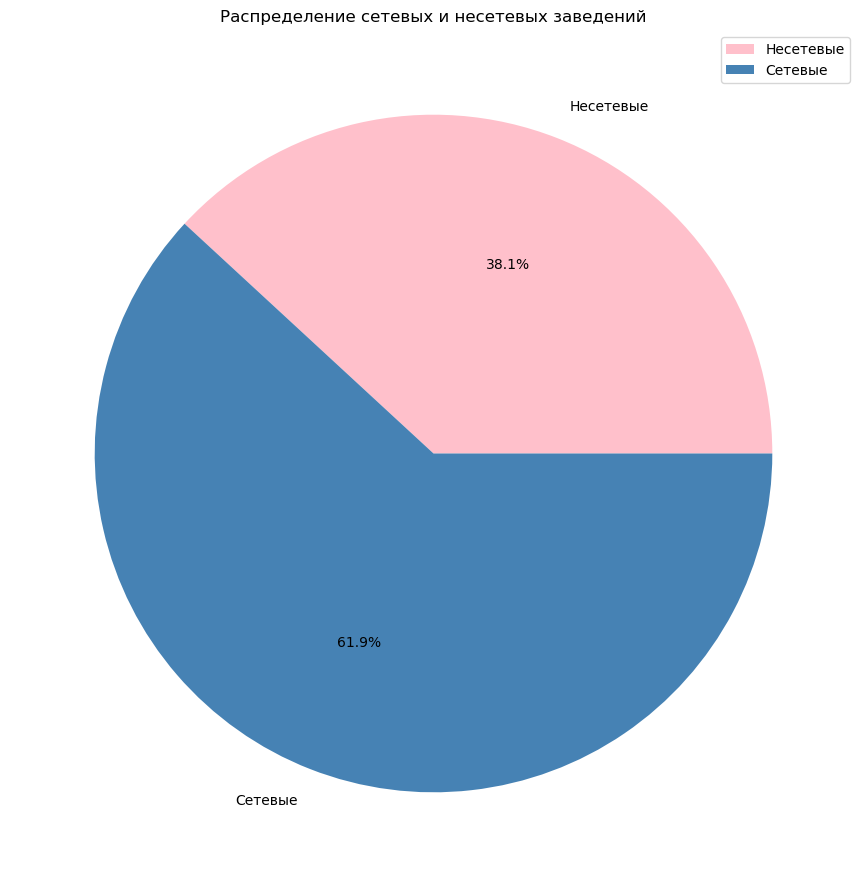

In [51]:
chain_count.plot(kind='pie', y='count',autopct='%1.1f%%',labels = ['Несетевые', 'Сетевые'],colors = ['pink', 'steelblue'],figsize = (15,11),title='Распределение сетевых и несетевых заведений')
plt.ylabel('');


61.7% заведений представленных в датасете - сети. Тем не менее почти 40% заведений остаются несетевыми.


#### Исследуем какие категории заведений чаще являются сетевыми

In [54]:
category_chain = places.pivot_table(index = 'category', columns = 'chain', values = 'name', aggfunc = 'count')
category_chain.columns = ['not_chain', 'chain']

In [55]:
category_chain ['not_chain(%)'] = (category_chain ['not_chain'] / (category_chain ['not_chain'] + category_chain ['chain']) * 100).round(0)
category_chain ['chain(%)'] = (category_chain ['chain'] / (category_chain ['not_chain'] + category_chain ['chain']) * 100).round(0)

category_chain = category_chain.sort_values (by='not_chain(%)')
category_chain

,not_chain,chain,not_chain(%),chain(%)
category,,,,
булочная,99,155,39.0,61.0
пиццерия,299,327,48.0,52.0
кофейня,692,718,49.0,51.0
быстрое питание,369,231,62.0,38.0
ресторан,1296,725,64.0,36.0
кафе,1589,772,67.0,33.0
столовая,226,88,72.0,28.0
"бар,паб",590,165,78.0,22.0


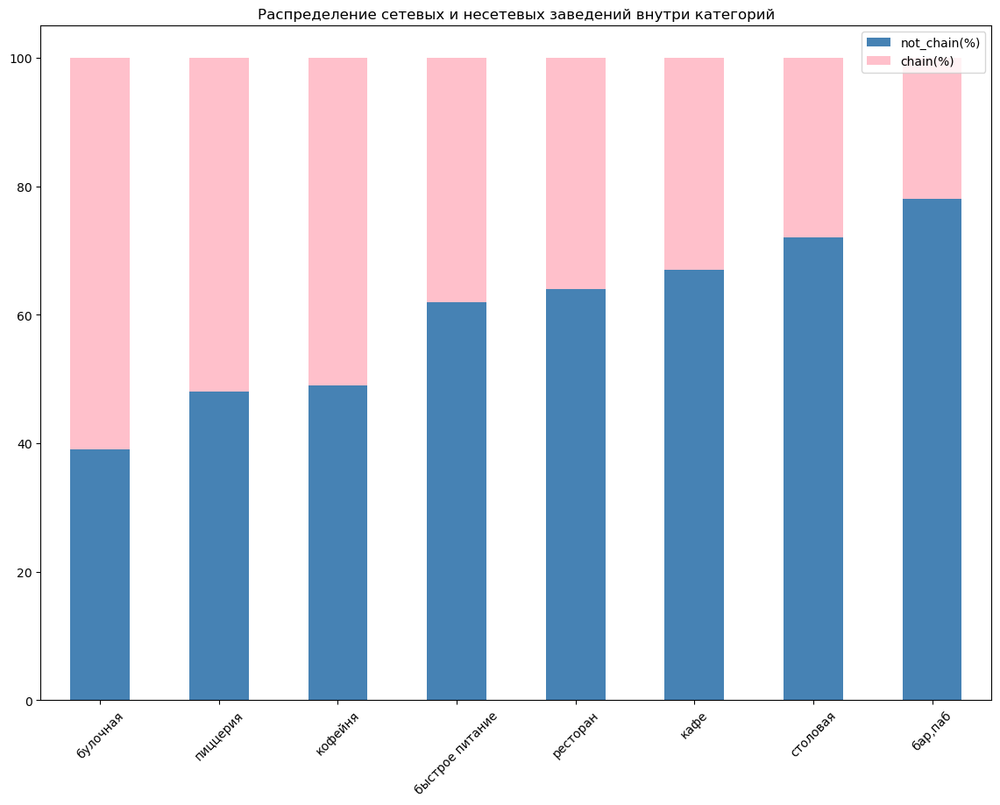

In [56]:
category_chain = category_chain.drop (columns = ['not_chain', 'chain'])

category_chain.plot(kind = 'bar',rot=45,color = ['steelblue','pink'],stacked = True, 
                    title='Распределение сетевых и несетевых заведений внутри категорий', figsize = (14,10));
plt.xlabel('');

Больше всего сетевых заведений среди булочных, пиццерий и кофеен. 

#### Найдем топ-15 популярных сетей в Москве

In [59]:
chains = places[places['chain'] == 1]

In [60]:
chains_count = chains.groupby('name')['address'].count().sort_values(ascending = False).reset_index()
#chains_count.columns = ['Сеть', 'Количество заведений']

top_15_chains = chains_count.head(15)
top_15_chains

,name,address
0,шоколадница,119
1,домино'с пицца,76
2,додо пицца,74
3,one price coffee,71
4,яндекс лавка,69
5,cofix,65
6,prime,50
7,хинкальная,43
8,кофепорт,42
9,теремок,38


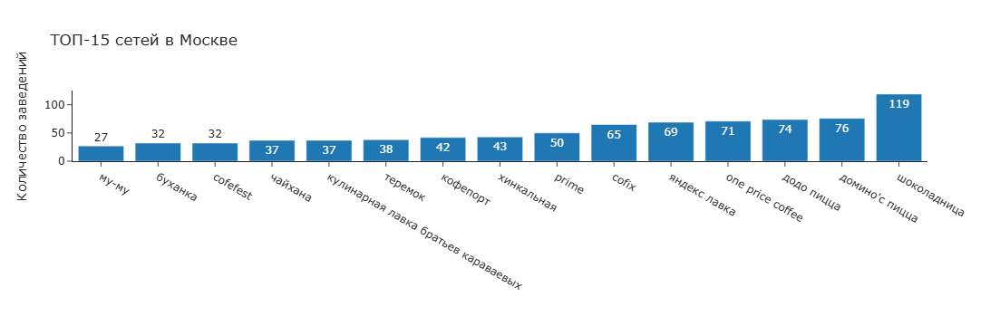

In [61]:
fig = px.bar(top_15_chains.head(15), 
             x='name', 
             y='address',
             text='address',
             title='ТОП-15 сетей в Москве',
             template='simple_white'
            )

fig.update_layout(xaxis_title='',
                  yaxis_title='Количество заведений',
                  xaxis={'categoryorder':'total ascending'})

fig.show()

Шоколадница лидирует с отрывом (категория - кофейня). Это одна из старейших сетей. В списке несколько сетевых кофеен.

In [63]:
chains_by_category_count = chains.groupby('name')[['name','category']].first().drop (columns = ['name']).reset_index()
top15_by_category = top_15_chains.merge (chains_by_category_count, on = 'name', how = 'left')

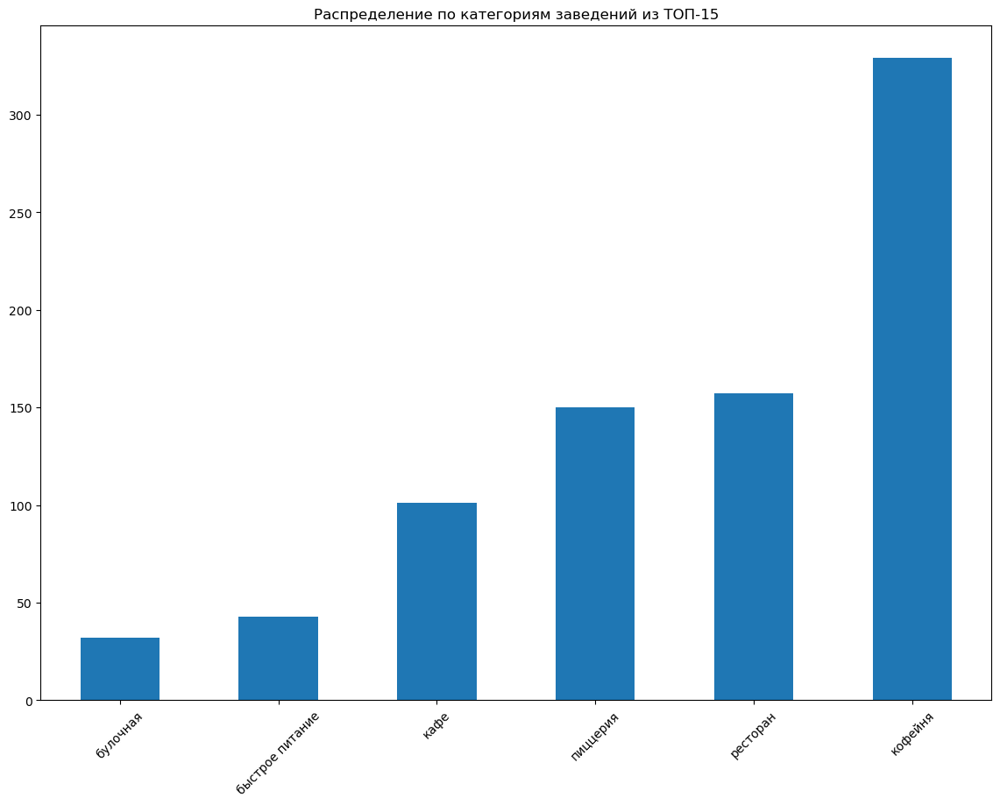

In [64]:
top15_by_category.groupby('category')['address'].sum().sort_values().plot(kind = 'bar',rot=45, x = 'category', figsize = (14,10))
plt.title ('Распределение по категориям заведений из ТОП-15');
plt.xlabel('');

На предыдущем графике мы обратили внимание на то что в ТОП-15 входит несколько кофеен. Этот график подвтвердил наши ожидания: кофеен больше всего среди ТОП-15 сетевых заведений.

#### Отобразим общее количество заведений и количество заведений каждой категории по районам

In [67]:
district_count = places.groupby('district')['name'].count().sort_values().reset_index()
district_count.columns = ['district', 'count']
district_count

,district,count
0,Северо-Западный административный округ,409
1,Юго-Западный административный округ,709
2,Юго-Восточный административный округ,712
3,Восточный административный округ,795
4,Западный административный округ,845
5,Северо-Восточный административный округ,888
6,Северный административный округ,891
7,Южный административный округ,891
8,Центральный административный округ,2201


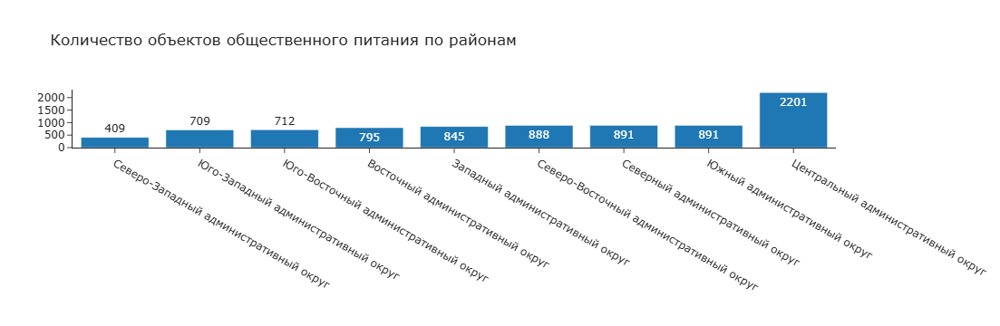

In [68]:
fig = px.bar(district_count, 
             x='district', 
             y='count', 
             text='count',
             title='Количество объектов общественного питания по районам',
             template='simple_white'
            )

fig.update_layout(xaxis_title='',
                  yaxis_title='',
                  )

fig.show()

В ЦАО больше всего заведений (в два раза больше среднего значения). В остальных районах распределение примерно одинаковое.

In [70]:
district_category = places.pivot_table (
    index = 'district', columns = 'category', values = 'name', aggfunc = 'count')
district_category['total'] = district_category['бар,паб'] + district_category['булочная'] + district_category['быстрое питание'] + district_category['кафе'] + district_category['кофейня'] + district_category['пиццерия'] + district_category['ресторан'] +district_category['столовая']
district_category.sort_values(by = ['total'], ascending = [False])

category,"бар,паб",булочная,быстрое питание,кафе,кофейня,пиццерия,ресторан,столовая,total
district,,,,,,,,,
Центральный административный округ,356,49,86,452,427,108,657,66,2201
Северный административный округ,67,38,57,234,193,77,185,40,891
Южный административный округ,68,25,84,264,131,73,202,44,891
Северо-Восточный административный округ,62,28,82,268,159,68,181,40,888
Западный административный округ,50,37,62,238,150,69,215,24,845
Восточный административный округ,53,25,71,271,104,72,159,40,795
Юго-Восточный административный округ,38,13,67,281,88,55,145,25,712
Юго-Западный административный округ,38,27,61,238,96,64,168,17,709
Северо-Западный административный округ,23,12,30,115,62,40,109,18,409


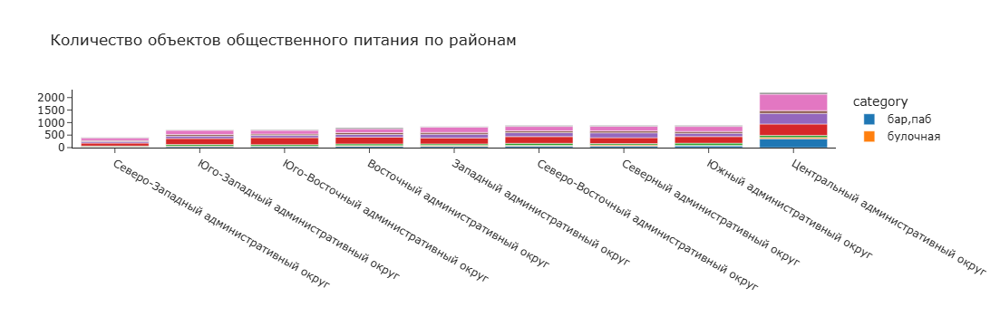

In [71]:
district_category = district_category.drop (columns = ['total'])

fig = px.bar(district_category, 
             title='Количество объектов общественного питания по районам',
             template='simple_white'
            )

fig.update_layout(xaxis_title='',
                  yaxis_title='',
                  xaxis={'categoryorder':'total ascending'})

fig.show()

Практически во всех районах доминирует категория "Кафе". На втором месте - рестораны. Замыкают тройку лидеров кофейни. Исключение - ЦАО. Здесь рестораны лидируют с отрывом. Бары, кафе и кофейни распределены примерно одинаково. 

#### Визуализируем распределение средних рейтингов по категориям заведений. Определим сильно ли различаются усреднённые рейтинги в разных типах общепита.

In [74]:
category_rating = places.pivot_table (index = 'category', values = 'rating', aggfunc = 'mean').sort_values(by='rating').round(2).reset_index()
category_rating.columns = ['категория', 'рейтинг']
category_rating

,категория,рейтинг
0,быстрое питание,4.05
1,кафе,4.12
2,столовая,4.21
3,булочная,4.27
4,кофейня,4.28
5,ресторан,4.29
6,пиццерия,4.30
7,"бар,паб",4.39


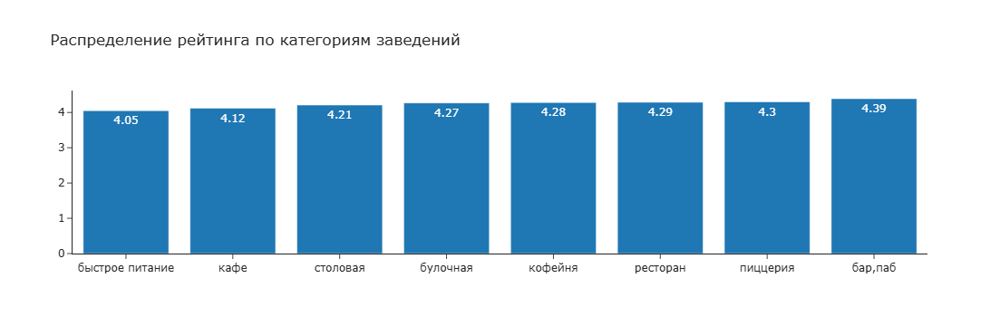

In [75]:
fig = px.bar(category_rating, 
             x='категория', 
             y='рейтинг',
             text='рейтинг',
             title='Распределение рейтинга по категориям заведений',
             template='simple_white'
            )

fig.update_layout(xaxis_title='',
                  yaxis_title='',
                  )

fig.show()

Рейтинг варьируется от 4.05 до 4.39. Самый высокий рейтинг у баров. Кофейни находятся по середине. 

#### Построем фоновую картограмму (хороплет) со средним рейтингом заведений каждого района

In [78]:
rating_district = places.groupby('district', as_index=False)['rating'].agg('mean').round(1)
rating_district

,district,rating
0,Восточный административный округ,4.2
1,Западный административный округ,4.2
2,Северный административный округ,4.2
3,Северо-Восточный административный округ,4.2
4,Северо-Западный административный округ,4.2
5,Центральный административный округ,4.4
6,Юго-Восточный административный округ,4.1
7,Юго-Западный административный округ,4.2
8,Южный административный округ,4.2


In [79]:
#!pip install folium

In [80]:
#!pip install geopandas

In [81]:
# импортируем карту и хороплет
from folium import Map, Choropleth
import geopandas as gpd

# загружаем JSON-файл с границами округов Москвы
#state_geo = '/users/gveviorski/admin_level_geomap.geojson'
state_geo = gpd.read_file('/users/gveviorski/admin_level_geomap.geojson', encoding='utf-8')

# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
moscow_lat, moscow_lng = 55.751244, 37.618423

# создаём карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

# создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
Choropleth(
    geo_data=state_geo,
    data=rating_district,
    columns=['district', 'rating'],
    key_on='feature.properties.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='Рейтинг заведений по районам',
).add_to(m)

# выводим карту
m

В центре находятся самые популярные места. На юго-востоке – заведения с наименьшим рейтингом.

#### Отобразим все заведения датасета на карте с помощью кластеров средствами библиотеки folium

In [84]:
# импортируем карту и маркер
from folium import Map, Marker
# импортируем кластер
from folium.plugins import MarkerCluster
# импортируем собственные иконки
from folium.features import CustomIcon

# создаём карту Москвы
m2 = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

# создаём пустой кластер, добавляем его на карту
marker_cluster = MarkerCluster().add_to(m2)

def create_clusters(row):
    # сохраняем URL-адрес изображения со значком торгового центра с icons8,
    # это путь к файлу на сервере icons8
    icon_url = 'https://img.icons8.com/external-wanicon-flat-wanicon/344/external-mall-shop-and-store-wanicon-flat-wanicon.png'  
    # создаём объект с собственной иконкой размером 30x30
    icon = CustomIcon(icon_url, icon_size=(30, 30))
    
    # создаём маркер с иконкой icon и добавляем его в кластер
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']}",
        icon=icon,
    ).add_to(marker_cluster)

# применяем функцию для создания кластеров к каждой строке датафрейма
places.apply(create_clusters, axis=1)

# выводим карту
m2

Больше всего заведений в центре. Меньше всего - на юге, юго-востоке и на востоке. Как известно, это наименее развитые районы Москвы.

#### Определим топ-15 улиц по количеству заведений. Построем график распределения количества заведений и их категорий по этим улицам. 

In [87]:
top_streets = places.groupby('street')['address'].count().sort_values(ascending = False)

top_15 = top_streets.head(15)
top_15


street
проспект Мира             182
Профсоюзная улица         122
проспект Вернадского      107
Ленинский проспект        107
Ленинградский проспект     93
Дмитровское шоссе          87
Каширское шоссе            77
Варшавское шоссе           76
Ленинградское шоссе        68
МКАД                       65
Люблинская улица           60
улица Вавилова             55
Кутузовский проспект       54
улица Миклухо-Маклая       49
Пятницкая улица            48
Name: address, dtype: int64

In [88]:
top_15_by_category = places.query('street in (@top_15.index)').pivot_table(index = 'street', columns = 'category', values = 'name', aggfunc = 'count')

top_15_by_category['total'] = top_15_by_category['бар,паб'] + top_15_by_category['булочная'].fillna(0) + top_15_by_category['быстрое питание'] + top_15_by_category['кафе'] + top_15_by_category['кофейня'] + top_15_by_category['пиццерия'].fillna(0) + top_15_by_category['ресторан'] + top_15_by_category['столовая'].fillna(0)
top_15_by_category.sort_values(by = ['total'], ascending = [False])

category,"бар,паб",булочная,быстрое питание,кафе,кофейня,пиццерия,ресторан,столовая,total
street,,,,,,,,,
проспект Мира,11.0,4.0,21.0,52.0,36.0,11.0,45.0,2.0,182.0
Профсоюзная улица,6.0,4.0,15.0,35.0,18.0,15.0,26.0,3.0,122.0
Ленинский проспект,10.0,3.0,2.0,26.0,23.0,5.0,33.0,5.0,107.0
проспект Вернадского,7.0,1.0,12.0,25.0,16.0,11.0,33.0,2.0,107.0
Ленинградский проспект,15.0,4.0,1.0,12.0,25.0,9.0,24.0,3.0,93.0
Дмитровское шоссе,5.0,2.0,10.0,23.0,11.0,8.0,24.0,4.0,87.0
Каширское шоссе,2.0,NaN,10.0,20.0,16.0,5.0,19.0,5.0,77.0
Варшавское шоссе,6.0,NaN,7.0,18.0,14.0,4.0,20.0,7.0,76.0
Ленинградское шоссе,5.0,2.0,5.0,13.0,13.0,3.0,24.0,3.0,68.0


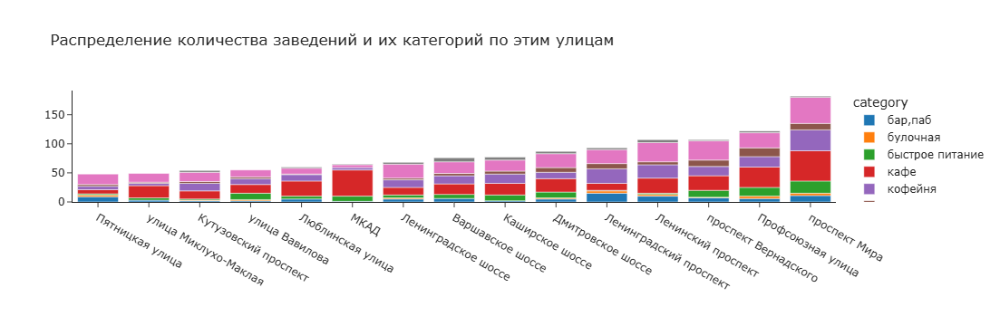

In [89]:

top_15_by_category = top_15_by_category.drop (columns = ['total'])

fig = px.bar(top_15_by_category, 
             title='Распределение количества заведений и их категорий по этим улицам',
             template='simple_white'
            )

fig.update_layout(xaxis_title='',
                  yaxis_title='',
                  xaxis={'categoryorder':'total ascending'})


fig.show()

Больше всего заведений на Проспекте Мира. Основная масса заведений приходится на: рестораны, кафе и кофейни. У первых четырех улиц распределение примерно одинаковое. На Ленинградском проспекте относительно много баров и меньше кафе. На МКАДе основная категория - "Кафе".

#### Найдем улицы, на которых находится только один объект общепита

In [92]:
top_streets = places.groupby('street')['address'].count().sort_values(ascending = True).reset_index()
top_streets
#top_streets.columns = ['улица', 'количество']
one_cafe_street = top_streets.query('address == 1')
one_cafe_street


,street,address
0,1-й Автозаводский проезд,1
1,Одинцовская улица,1
2,Октябрьский переулок,1
3,Ордынский тупик,1
4,Оренбургская улица,1
...,...,...
459,4-я улица 8 Марта,1
460,3-й проезд Перова Поля,1
461,Большой Сухаревский переулок,1
462,1-й Щипковский переулок,1


Довольно много (5%) улиц с одним заведением.

#### Посчитаем медиану среднего чека по каждому району 

In [95]:
avg_bill_district = places.groupby('district', as_index=False)['middle_avg_bill'].agg('median').sort_values (by='middle_avg_bill')
avg_bill_district

,district,middle_avg_bill
6,Юго-Восточный административный округ,450.0
3,Северо-Восточный административный округ,500.0
8,Южный административный округ,500.0
0,Восточный административный округ,550.0
7,Юго-Западный административный округ,600.0
2,Северный административный округ,650.0
4,Северо-Западный административный округ,700.0
1,Западный административный округ,975.0
5,Центральный административный округ,1000.0


In [96]:
# создаём карту Москвы
m3 = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

# создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
Choropleth(
    geo_data=state_geo,
    data=avg_bill_district,
    columns=['district', 'middle_avg_bill'],
    key_on='feature.properties.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='Средний чек',
).add_to(m3)

# выводим карту
m3

В датасете 5257 пропусков в данных по среднему чеку. Самые дорогие заведения находятся в ЦАО, на западе и на юго-западе Москвы. Как известно, это самые дорогие районы Москвы. Здесь самая высокая стоимость недвижимости. Соответственно здесь самая высокая аренда коммерческих помещений. 

Общий вывод:

1. Был получен фаил с данными по заведениям общественного питания Москвы, составленный на основе данных сервисов Яндекс Карты и Яндекс Бизнес на лето 2022 года. После загрузки данных, была изучена общая информация
2. Была проведена предобработка данных:
    - Были выявлены пропуски в следующих столбцах: middle_coffee_cup (94% данных отсутствуют); middle_avg_bill(62.5%); price(60.6%); avg_bill(54.6%); seats(43%). 
    - Явные дубликаты не обнаружены
    - Найдены и удалены три заведения с одинаковым адресом и названием
    - Дубликаты среди районов и категорий не выявлены
    - Добавлен столбец "Street" с указанием улицы
    - Добавлен столбец "is_24/7" с указанием заведений, работающих круглосуточно
    - Была проведена проверка количественных значений. Были выявлены аномальные значения в столбцах: middle_avg_bill; middle_coffee_cup и seats. Были удалены 61 строка со значениями больше 3000 рублей в столбце middle_avg_bill. Также была удалена 1 строка со значением 1568 рублей в столбце middle_coffee_cup. Заведения где посадочных мест больше 300 оказалось довольно много (3%). Оставляем их в датасете.
    
3. Был проведен исследовательский анализ данных, в ходе которого было выявлено:
    - Количество объектов общественного питания по видам. Первая тройка лидеров: кафе (2361 штук); рестораны (2021 штук); кофейни (1410 штук).
    - Количество посадочных мест варьируется от 50 до 85. Больше всего в ресторанах. Меньше всего в булочных. Кофейни (на третьем месте) в среднем имеют 80 посадочных мест.
    - 61.7% заведений представленных в датасете - сети. Больше всего сетевых заведений среди булочных, пиццерий и кофеен. 
    - Были выявлены ТОП-15 сетей Москвы. Шоколадница лидирует с отрывом (категория - кофейня). Более того, категория "Кофейня" - самая многочисленная среди ТОП-15 сетевых заведений.
    - В ЦАО больше всего заведений (примерно в два раза больше среднего значения). В остальных районах распределение примерно одинаковое.
    - Практически во всех районах доминирует категория "Кафе". На втором месте - рестораны. Замыкают тройку лидеров кофейни. Исключение - ЦАО. Здесь рестораны лидируют с отрывом. Бары, кафе и кофейни распределены примерно одинаково. 
    - Рейтинг заведений Москвы варьируется от 4.05 до 4.39. Самый высокий рейтинг у баров. Кофейни находятся по середине (4.28). Самые популярные места находятся в центре.На юго-востоке – заведения с наименьшим рейтингом.
    - Больше всего заведений в центре. Меньше всего - на юге, юго-востоке и на востоке. 
    - Были выявлены ТОП-15 улиц. Больше всего заведений на Проспекте Мира. Основная масса заведений приходится на: рестораны, кафе и кофейни. У первых четырех улиц распределение примерно одинаковое. На Ленинградском проспекте относительно много баров и меньше кафе. На МКАДе основная категория - "Кафе".
    - Исследование среднего чека: самые дорогие заведения находятся в ЦАО, на западе и на юго-западе Москвы. Как известно, это самые дорогие районы Москвы. Здесь самая высокая стоимость недвижимости. Соответственно здесь самая высокая аренда коммерческих помещений. Для информации: в датасете 5257 пропусков в данных по среднему чеку.
 


### Шаг 4. Открытие кофейни

#### Выделим кофейни из датасета

In [101]:
coffee_shops = places[places['category'] == 'кофейня']
coffee_shops.head(3)

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7
3,dormouse coffee shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN,улица Маршала Федоренко,False
25,в парке вкуснее,кофейня,"Москва, парк Левобережный",Северный административный округ,"ежедневно, 10:00–21:00",55.878453,37.460028,4.3,NaN,NaN,NaN,NaN,1,NaN,парк Левобережный,False
45,9 bar coffee,кофейня,"Москва, Коровинское шоссе, 41, стр. 1",Северный административный округ,пн-пт 08:00–18:00,55.885837,37.513422,4.0,NaN,NaN,NaN,NaN,1,46.0,Коровинское шоссе,False


In [102]:
coffee_shops.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1410 entries, 3 to 8400
Data columns (total 16 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               1410 non-null   object 
 1   category           1410 non-null   object 
 2   address            1410 non-null   object 
 3   district           1410 non-null   object 
 4   hours              1395 non-null   object 
 5   lat                1410 non-null   float64
 6   lng                1410 non-null   float64
 7   rating             1410 non-null   float64
 8   price              474 non-null    object 
 9   avg_bill           719 non-null    object 
 10  middle_avg_bill    200 non-null    float64
 11  middle_coffee_cup  519 non-null    float64
 12  chain              1410 non-null   int64  
 13  seats              750 non-null    float64
 14  street             1410 non-null   object 
 15  is_24/7            1395 non-null   object 
dtypes: float64(6), int64(1), obje

В Москве 1412 кофейн. Это 16% от всех заведений. Данные по среднему чеку, средней стоимости чашки капучино и количеству посадочных мест частично отсутствуют.

#### Посмотрим распределене кофейн по районам

In [105]:
# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
moscow_lat, moscow_lng = 55.751244, 37.618423

# создаём карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)
# создаём пустой кластер, добавляем его на карту
marker_cluster = MarkerCluster().add_to(m)

def create_clusters(row):
    # сохраняем URL-адрес изображения со значком торгового центра с icons8,
    # это путь к файлу на сервере icons8
    icon_url = 'https://img.icons8.com/external-wanicon-flat-wanicon/344/external-mall-shop-and-store-wanicon-flat-wanicon.png'  
    # создаём объект с собственной иконкой размером 30x30
    icon = CustomIcon(icon_url, icon_size=(30, 30))
    
    # создаём маркер с иконкой icon и добавляем его в кластер
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']}",
        icon=icon,
    ).add_to(marker_cluster)

# применяем функцию для создания кластеров к каждой строке датафрейма
coffee_shops.apply(create_clusters, axis=1)

# выводим карту
m



Больше всего кофеен в центре, на севере и на юго-западе

#### Посмотрим как распределяются рейтинги по районам

In [108]:
# создаём карту Москвы
m4 = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

# создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
Choropleth(
    geo_data=state_geo,
    data=coffee_shops,
    columns=['district', 'rating'],
    key_on='feature.properties.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='Рейтинг кофеен по районам',
).add_to(m4)

# выводим карту
m4

Неожиданный результат: кофейни с самым высоким рейтингом, напротив, находятся на севере и востоке.

#### Посмотрим как меняется средний чек в зависимости от района

In [111]:
avg_bill_coffee_shops = coffee_shops.groupby('district', as_index=False)['middle_avg_bill'].agg('median').sort_values(by='middle_avg_bill')
avg_bill_coffee_shops

,district,middle_avg_bill
6,Юго-Восточный административный округ,250.0
2,Северный административный округ,325.0
3,Северо-Восточный административный округ,325.0
4,Северо-Западный административный округ,325.0
7,Юго-Западный административный округ,375.0
8,Южный административный округ,387.5
0,Восточный административный округ,400.0
5,Центральный административный округ,500.0
1,Западный административный округ,600.0


In [112]:
# создаём карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

# создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
Choropleth(
    geo_data=state_geo,
    data=avg_bill_coffee_shops,
    columns=['district', 'middle_avg_bill'],
    key_on='feature.properties.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='Средний чек в кофейнях по районам',
).add_to(m)

# выводим карту
m

Средний чек совпадает со стоимостью квадратного метра: самые дорогие кофейни в центре и на юго-западном направлении. Но здесь представлены всего 200 кофеен из 1412.

#### Проанлизируем стоимость чашки кофе

In [115]:
middle_coffee_cup = coffee_shops.groupby('district', as_index=False)['middle_coffee_cup'].agg('median')
middle_coffee_cup

,district,middle_coffee_cup
0,Восточный административный округ,135.0
1,Западный административный округ,189.0
2,Северный административный округ,159.0
3,Северо-Восточный административный округ,162.5
4,Северо-Западный административный округ,165.0
5,Центральный административный округ,190.0
6,Юго-Восточный административный округ,145.0
7,Юго-Западный административный округ,198.0
8,Южный административный округ,150.0


In [116]:
# создаём карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

# создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
Choropleth(
    geo_data=state_geo,
    data=middle_coffee_cup,
    columns=['district', 'middle_coffee_cup'],
    key_on='feature.properties.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='Стоимость чашки кофе',
).add_to(m)

# выводим карту
m

В датасете 520 значений цены за чашку капучино. Это меньше 40%, но в 2.5 раза больше чем данных по среднему чеку. График в целом повторяет график со средним чеком (исключение - Восточный административный округ). Самая высокая цена на юго-западном направлении.

#### Проанализируем соотношение сетевых и несетевых кофеен по районам

In [119]:
coffee_shops_chain = coffee_shops.pivot_table(index = 'district', columns = 'chain', values = 'name', aggfunc = 'count')
coffee_shops_chain.columns = ['not_chain', 'chain']

In [120]:
coffee_shops_chain ['not_chain(%)'] = (coffee_shops_chain ['not_chain'] / (coffee_shops_chain ['not_chain'] + coffee_shops_chain ['chain']) * 100).round(0)
coffee_shops_chain ['chain(%)'] = (coffee_shops_chain ['chain'] / (coffee_shops_chain ['not_chain'] + coffee_shops_chain ['chain']) * 100).round(0)

coffee_shops_chain = coffee_shops_chain.sort_values (by='not_chain(%)')
coffee_shops_chain

,not_chain,chain,not_chain(%),chain(%)
district,,,,
Западный административный округ,57,93,38.0,62.0
Северо-Западный административный округ,28,34,45.0,55.0
Центральный административный округ,206,221,48.0,52.0
Юго-Западный административный округ,46,50,48.0,52.0
Северный административный округ,96,97,50.0,50.0
Северо-Восточный административный округ,80,79,50.0,50.0
Южный административный округ,65,66,50.0,50.0
Восточный административный округ,54,50,52.0,48.0
Юго-Восточный административный округ,60,28,68.0,32.0


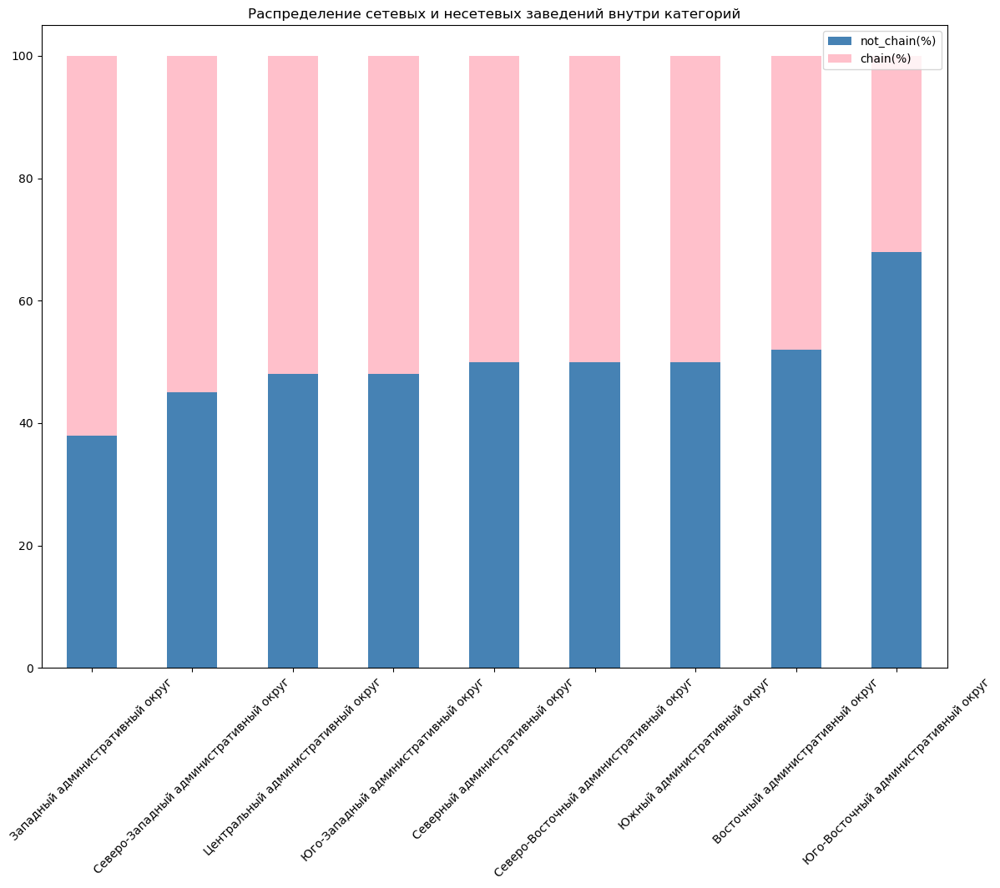

In [121]:
coffee_shops_chain = coffee_shops_chain.drop (columns = ['not_chain', 'chain'])

coffee_shops_chain.plot(kind = 'bar',rot=45,color = ['steelblue','pink'],stacked = True, 
                    title='Распределение сетевых и несетевых заведений внутри категорий', figsize = (14,10));
plt.xlabel('');

Меньше всего сетевых кофеен на восточном направлении. Там же самые высокие рейтинги. Получается что локальные кофейни имеют в среднем более высокий рейтинг.

#### Проанализуем наличие круглосуточных кофеен

In [124]:
coffee_shops_hours = coffee_shops.groupby('is_24/7')['address'].count().sort_values().reset_index()
coffee_shops_hours

,is_24/7,address
0,True,59
1,False,1336


Кофеен, которые работают кгуглосуточно, всего 59.

#### Проанализируем количество посадочных мест

In [127]:
middle_coffee_seats = coffee_shops.groupby('district', as_index=False)['seats'].agg('median')
middle_coffee_seats

,district,seats
0,Восточный административный округ,55.0
1,Западный административный округ,96.0
2,Северный административный округ,66.0
3,Северо-Восточный административный округ,75.0
4,Северо-Западный административный округ,87.5
5,Центральный административный округ,86.0
6,Юго-Восточный административный округ,50.0
7,Юго-Западный административный округ,64.5
8,Южный административный округ,80.0


In [128]:
# создаём карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

# создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
Choropleth(
    geo_data=state_geo,
    data=middle_coffee_seats,
    columns=['district', 'seats'],
    key_on='feature.properties.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='Количество посадочных мест',
).add_to(m)

# выводим карту
m

Есть 750 строк (53%) с данными по посадочным местам. Из них видно что в районах где меньше сетей, меньше средний чек, расположены небольшие кофейни (50-60 посадочных мест). На более дорогом направлении (юго-запад) расположены большие кофейни (96 посадочных мест в среднем). В ЦАО количество кофеен немного меньше. Возможно, это связано с дороговизной аренды.

#### Рекомендации по открытию нового заведения.

Открывать кофейню стоит на юго-восточном направлении. Здесь находится всего 189 кофеен (13%). 
Мы выяснили что на юго-восточном направлении рейтинг кофеен средний (выше только на востоке и на северо-востоке). Нужно сделать ставку на качество.
Также здесь меньше всего сетевых заведений. Соответственно это направление подходит для открытия отдельной кофейни.
Количество посадочных мест: 50.
Цена чашки капучино – 147.50 рублей.



Ссылка на презентацию: https://disk.yandex.ru/i/Qc-OXNRqnQ5n7g